In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt

In [3]:
df=pd.read_csv('data.csv')
df['date']=pd.to_datetime(df['date'],format='%d/%m/%Y')
df.set_index('date',inplace=True)
df=df.asfreq('D')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 7304 entries, 2003-01-02 to 2022-12-31
Freq: D
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   us      7304 non-null   float64
 1   vs      7304 non-null   float64
 2   rh      7304 non-null   float64
 3   temp    7304 non-null   float64
 4   o3      7304 non-null   float64
 5   co      7304 non-null   float64
 6   no      7304 non-null   float64
 7   no2     7304 non-null   float64
 8   so2     7304 non-null   float64
 9   pm1     7304 non-null   float64
 10  pm10    7304 non-null   float64
 11  pm2.5   7304 non-null   float64
dtypes: float64(12)
memory usage: 741.8 KB


In [4]:
df.describe()

,us,vs,rh,temp,o3,co,no,no2,so2,pm1,pm10,pm2.5
count,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000,7304.000000
mean,-0.242098,0.028053,76.334670,293.060210,94.923322,19.415875,0.013408,0.109014,0.127756,200.874535,339.809310,242.702232
std,1.563461,1.098521,17.112741,7.589522,6.266703,4.028107,0.015061,0.033003,0.046240,100.846425,160.619634,112.025011
min,-6.497691,-4.537613,17.343384,275.127000,74.415626,12.363140,0.000035,0.041605,0.015545,16.700000,27.900000,19.800000
25%,-1.433821,-0.712528,67.719327,286.173455,91.310392,16.733373,0.001247,0.086106,0.094031,115.000000,209.000000,153.000000
50%,-0.349917,0.126109,80.626823,294.411655,94.299521,18.540717,0.008001,0.103175,0.120701,187.000000,315.000000,226.000000
75%,1.153393,0.828679,88.811101,299.941622,97.910344,20.988390,0.021031,0.125731,0.153925,277.000000,460.000000,326.000000
max,4.276106,4.940400,103.836060,306.676100,130.701004,49.411794,0.093879,0.339854,0.502923,557.000000,913.000000,648.000000


In [5]:
df.skew()

us      -0.122755
vs      -0.249714
rh      -0.955276
temp    -0.313794
o3       0.771395
co       1.841748
no       1.476753
no2      1.217018
so2      0.985381
pm1      0.441537
pm10     0.455881
pm2.5    0.442401
dtype: float64

In [6]:
df.kurtosis()

us      -0.721497
vs       0.035580
rh       0.303062
temp    -1.231685
o3       2.107797
co       5.682462
no       2.136013
no2      2.692403
so2      1.944755
pm1     -0.758977
pm10    -0.672664
pm2.5   -0.638618
dtype: float64

In [4]:
labels={"us":"U-Component of Wind Speed (m/s)","vs":"V-Component of Wind Speed (m/s)",'o3':"Ozone (ug/m3)",'co':"Carbon DiOxide (ug/m3)","no":"Nitrogen Oxide (ug/m3)","no2":'Nitrogen DiOxide (ug/m3)','pm1':'Particulate Matter 1 (ug/m3)',"so2":'Sulpher DiOxide (ug/m3)',"pm10":"Particulate Matter 10 (ug/m3)","pm2.5":"Particulate Matter 2.5 (ug/m3)","temp":'Temperature (K)',"rh":"Relative Humidity (%)","p":"Surface Pressure (Pa)"}

In [8]:
len(labels)

13

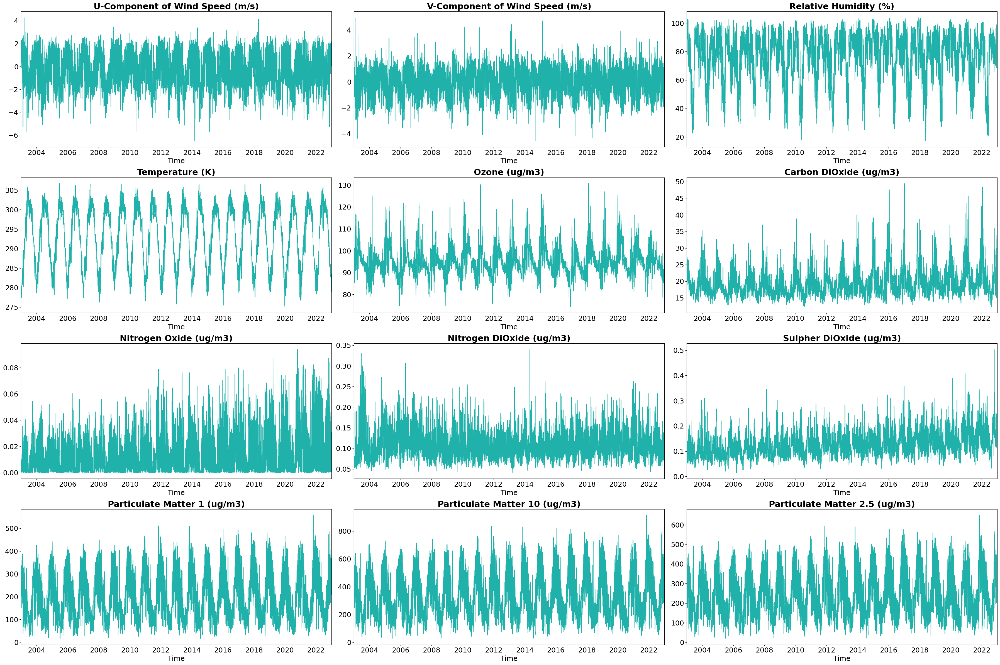

In [9]:
from matplotlib.dates import DateFormatter, AutoDateLocator
import datetime as dt

num_cols = len(df.columns)
num_rows = -(-num_cols // 3)  # Ceil division to ensure all columns are covered

fig, axs = plt.subplots(num_rows, 3, figsize=(36, 24))  # 3 columns

# Flatten the axs array if num_rows > 1 for easier iteration
if num_rows > 1:
    axs = axs.flatten()

for i, column in enumerate(df.columns):
    axs[i].set_xlim([dt.datetime(2003, 1, 1), dt.datetime(2022, 12, 31)])
    axs[i].set_title(labels[column], fontsize=22, fontweight='bold')  # Adjust title text
    axs[i].set_xlabel('Time', fontsize=18)  # Adjust x-axis label
    axs[i].tick_params(axis='both', which='major', labelsize=18)  # Adjust tick labels
    axs[i].plot(df.index, df[column], color='lightseagreen')

# Hide empty subplots if the number of subplots is not a perfect square
if num_cols % 3 != 0:
    for i in range(num_cols, num_rows * 3):
        axs[i].axis('off')

plt.tight_layout()
plt.show()


In [10]:
df['Month'] = df.index.month  # Create a new column for month
df['Year'] = df.index.year

In [11]:
monthly=pd.DataFrame()
for n in range(1,13):
    specific_month_data = df[df['Month'] == n]
    monthly[n] = specific_month_data.mean()

In [5]:
import matplotlib as mpl
import numpy as np
from matplotlib.cm import ScalarMappable

In [13]:
monthly

,1,2,3,4,5,6,7,8,9,10,11,12
us,0.799444,0.300446,0.214461,-0.321804,-0.649681,-0.988688,-1.632519,-1.205197,-0.708648,-0.148024,0.589385,0.880577
vs,-0.138609,-0.253060,-0.525499,-0.758503,-0.173846,0.524889,0.531414,0.429293,0.410003,0.301279,-0.046785,0.011410
rh,88.251370,82.865816,75.410731,59.554407,49.280490,60.217844,84.014457,87.554947,85.762436,77.223170,80.355444,85.496154
temp,281.298790,284.587454,289.426342,294.667294,299.270540,301.800790,301.290686,300.601238,298.594597,293.987239,287.924299,282.849316
o3,95.960152,97.989540,98.928208,99.053415,98.566270,96.886543,94.728947,93.344359,92.402271,90.862115,89.774849,90.806023
co,23.929594,21.533989,19.649299,18.281250,18.422585,17.230157,16.656731,16.897491,18.189372,19.100845,20.736900,22.453412
no,0.015530,0.016304,0.017223,0.012647,0.012127,0.007575,0.003187,0.005253,0.013229,0.022632,0.019579,0.015854
no2,0.115627,0.103340,0.095810,0.096249,0.124896,0.114712,0.114672,0.112093,0.103462,0.100716,0.107765,0.117892
so2,0.119633,0.129713,0.127440,0.120641,0.135193,0.123053,0.098569,0.101128,0.135527,0.158708,0.151676,0.132589
pm1,287.640388,250.971504,223.864194,172.382500,162.690645,113.813833,93.703065,96.025806,149.854667,254.167419,305.550333,302.417419


In [14]:
monthly.columns

Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12], dtype='int64')

In [15]:
monthly.index

Index(['us', 'vs', 'rh', 'temp', 'o3', 'co', 'no', 'no2', 'so2', 'pm1', 'pm10',
       'pm2.5', 'Month', 'Year'],
      dtype='object')

for n in monthly.index[:-2]:
       plt.style.use('ggplot')
       fig, ax = plt.subplots()
       colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
       bounds = [0, 0.2, 0.4, 0.6, 0.8, 1]  # Position of each color, from 0 to 1
       cmap = mpl.colors.LinearSegmentedColormap.from_list('my_colormap', list(zip(bounds, colors)))
       norm = plt.Normalize(monthly.loc[n].min(), monthly.loc[n].max())
       colors = cmap(norm(monthly.loc[n]))
       ax.bar(monthly.loc[n].index.astype(str),monthly.loc[n],
              yerr=monthly.loc[n].std() / np.sqrt(len(monthly.loc[n])),
              color=colors)
       fig.colorbar(ScalarMappable(cmap=cmap, norm=norm))
       ax.set_xlabel('Months')
       ax.set_ylabel(labels[n])
       plt.tight_layout()
       plt.show()

import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
plt.style.use('ggplot')
fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(16, 20))
colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
bounds = [0, 0.2, 0.4, 0.6, 0.8, 1]  # Position of each color, from 0 to 1
cmap = mpl.colors.LinearSegmentedColormap.from_list('my_colormap', list(zip(bounds, colors)))

# Assuming "monthly" and "labels" are defined somewhere in your code for the data

for i, n in enumerate(monthly.index[:-2]):
    if i < 13:
        row = i // 3
        col = i % 3

        # Shift the last plot from the 1st column in the 5th row to the 2nd column
        if i == 12:  # For the last plot
            row = 4  # 5th row
            col = 1  # 2nd column

        ax = axs[row, col]

        norm = plt.Normalize(monthly.loc[n].min(), monthly.loc[n].max())
        colors = cmap(norm(monthly.loc[n]))

        ax.bar(monthly.loc[n].index.astype(str), monthly.loc[n],
               yerr=monthly.loc[n].std() / np.sqrt(len(monthly.loc[n])),
               color=colors)

        ax.set_xlabel('Months')
        ax.set_ylabel(labels[n])
        #ax.grid(False)

plt.tight_layout()
plt.show()

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
from pylab import rcParams
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.linear_model import LinearRegression
import numpy as np
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
import statsmodels as sm
from statsmodels.tsa import api as smt
#from metrics import evaluate
from tqdm import tqdm
from statsmodels.tsa.holtwinters import ExponentialSmoothing, SimpleExpSmoothing
import statsmodels.api as sm
import pmdarima as pm
from sklearn.preprocessing import StandardScaler
from sklearn import linear_model, svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
import xgboost as xgb
import lightgbm as lgb
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
warnings.filterwarnings("ignore")

In [17]:
dfy=df[-365:]

In [45]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Assuming dfy is your DataFrame containing the data

# Create a figure and axis
num_cols = 3
num_rows = len(dfy.columns[:-2])  # Each column will have 3 subplots (trend, seasonal, residual)
fig, axs = plt.subplots(num_rows, num_cols, figsize=(128, 64))
for i, col in enumerate(dfy.columns[:-2]):
    decomp = seasonal_decompose(dfy[col], model='additive')
    
    axs[i, 0].plot(decomp.trend, linewidth=3,color='red')  # Adjust line width in the plot function
    axs[i,0].set_ylabel(dfy.columns[i], fontsize=48)
    axs[i, 1].plot(decomp.seasonal, linewidth=3,color='blue')  # Adjust line width in the plot function
    
    axs[i, 2].scatter(dfy.index,decomp.resid, linewidth=3,color='green')  # Adjust line width in the plot function
    axs[i, 2].plot(dfy.index,[0]*len(dfy), linewidth=3,color='black')
    for j in range(3):
        axs[i, j].tick_params(axis='both', which='major', labelsize=28)  # Increase tick label size

axs[0,0].set_title('Trend', fontsize=48)
axs[0,1].set_title('Seasonal', fontsize=48)
axs[0,2].set_title('Residual', fontsize=48)
plt.tight_layout()
plt.show()

In [41]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Assuming dfy is your DataFrame containing the data

# Create a figure and axis
num_cols = 3
num_rows = len(dfy.columns[2:-2])  # Each column will have 3 subplots (trend, seasonal, residual)
fig, axs = plt.subplots(num_rows, num_cols, figsize=(128, 64))

for i, col in enumerate(dfy.columns[2:-2]):
    decomp = seasonal_decompose(dfy[col], model='multiplicative')
    
    axs[i, 0].plot(decomp.trend, linewidth=3,color='red')  # Adjust line width in the plot function
    axs[i,0].set_ylabel(dfy.columns[2+i], fontsize=48)
    axs[i, 1].plot(decomp.seasonal, linewidth=3,color='blue')  # Adjust line width in the plot function
    
    axs[i, 2].scatter(dfy.index,decomp.resid, linewidth=3,color='green')  # Adjust line width in the plot function
    axs[i, 2].plot(dfy.index,[0]*len(dfy), linewidth=3,color='black')
    for j in range(3):
        axs[i, j].tick_params(axis='both', which='major', labelsize=28)  # Increase tick label size

axs[0,0].set_title('Trend', fontsize=48)
axs[0,1].set_title('Seasonal', fontsize=48)
axs[0,2].set_title('Residual', fontsize=48)

plt.tight_layout()
plt.show()

In [53]:
dfyw=dfy.resample('W').mean()

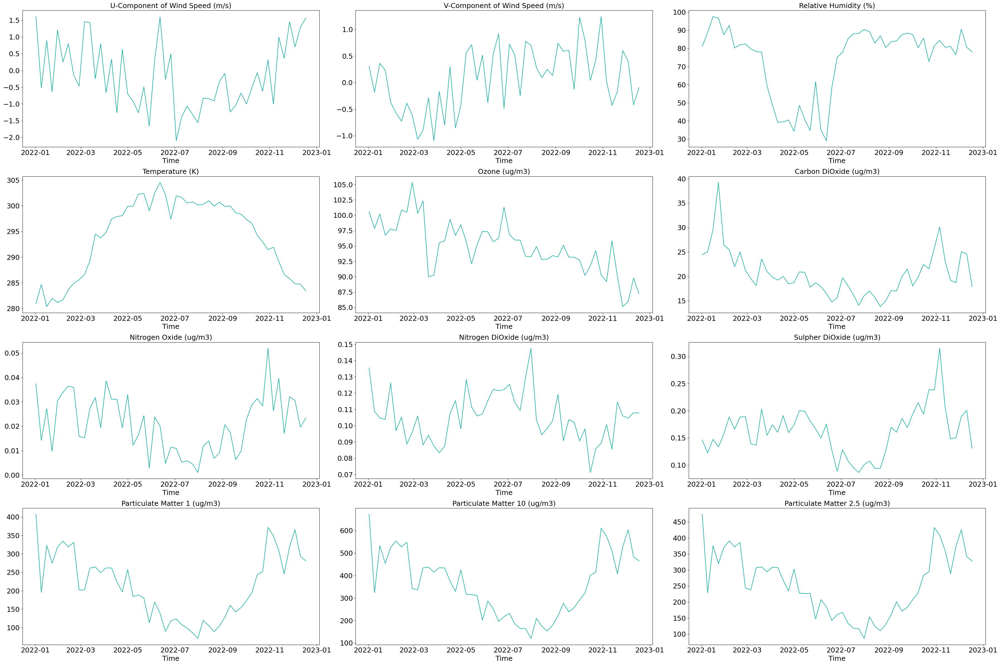

In [60]:
from matplotlib.dates import DateFormatter, AutoDateLocator
import datetime as dt


# Set font properties
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'font.size': 12
})

num_cols = len(df.columns)
num_rows = num_cols  # Each column will have two subplots (ACF and PACF)
fig, axs = plt.subplots(num_rows, 2, figsize=(24, 5 * num_rows), dpi=600)

for i, column in enumerate(df.columns):
    plot_acf(df[column], lags=100, ax=axs[i, 0], color='green')
    axs[i, 0].set_title(f'ACF - {labels[column]}')
    
    plot_pacf(df[column], lags=50, ax=axs[i, 1], color='purple')
    axs[i, 1].set_title(f'PACF - {labels[column]}')

plt.tight_layout()
plt.show()



In [61]:
def adftester(list):
    result = adfuller(list)
    #print('ADF Statistic: {}'.format(result[0]))
    print('p-value: {}'.format(result[1]))
    #print('Critical Values:')
    #for key, value in result[4].items():
    #    print('\t{}: {}'.format(key, value))

In [65]:
df=df[df.columns[:-2]]

In [66]:
for column in df.columns:
    print(column)
    adftester(df[column])

us
p-value: 6.406283096793589e-10
vs
p-value: 1.5258618603825216e-15
rh
p-value: 2.403495620777441e-15
temp
p-value: 4.142563302197243e-10
o3
p-value: 1.277875356690732e-10
co
p-value: 1.469370330762491e-12
no
p-value: 2.9126718999024277e-12
no2
p-value: 1.443435006659404e-15
so2
p-value: 7.249073809254774e-14
pm1
p-value: 2.5218746492809556e-08
pm10
p-value: 6.507902603596739e-08
pm2.5
p-value: 1.892039933772801e-08


In [16]:
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'font.size': 32
})

num_cols = len(df.columns)
num_rows = num_cols  # Each column will have two subplots (ACF and PACF)
fig, axs = plt.subplots(num_rows, 2, figsize=(60, 5 * num_rows), dpi=180)

for i, column in enumerate(df.columns):
    plot_acf(df[column], lags=100, ax=axs[i, 0], color='green')
    axs[i, 0].set_title(f'ACF - {labels[column]}')
    
    plot_pacf(df[column], lags=50, ax=axs[i, 1], color='purple')
    axs[i, 1].set_title(f'PACF - {labels[column]}')

plt.tight_layout()
plt.show()

In [8]:
import pandas as pd
from pmdarima.arima.utils import ndiffs
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
import warnings
warnings.filterwarnings("ignore")

In [78]:
for n in df.columns:
    print(f"{labels[n]},{ndiffs(df[n], test='adf')},{ndiffs(df[n], test='kpss')},{ndiffs(df[n], test='pp')}")

U-Component of Wind Speed (m/s),0,0,0
V-Component of Wind Speed (m/s),0,1,0
Relative Humidity (%),0,0,0
Temperature (K),0,0,0
Ozone (ug/m3),0,0,0
Carbon DiOxide (ug/m3),0,1,0
Nitrogen Oxide (ug/m3),0,1,0
Nitrogen DiOxide (ug/m3),0,1,0
Sulpher DiOxide (ug/m3),0,1,0
Particulate Matter 1 (ug/m3),0,0,0
Particulate Matter 10 (ug/m3),0,0,0
Particulate Matter 2.5 (ug/m3),0,0,0


In [ ]:
for n in df.columns:
    fig, axes = plt.subplots(1, 2, sharex=True)
    axes[0].plot(df[n].diff()); axes[0].set_title('1st Differencing')
    axes[1].plot(df[n])

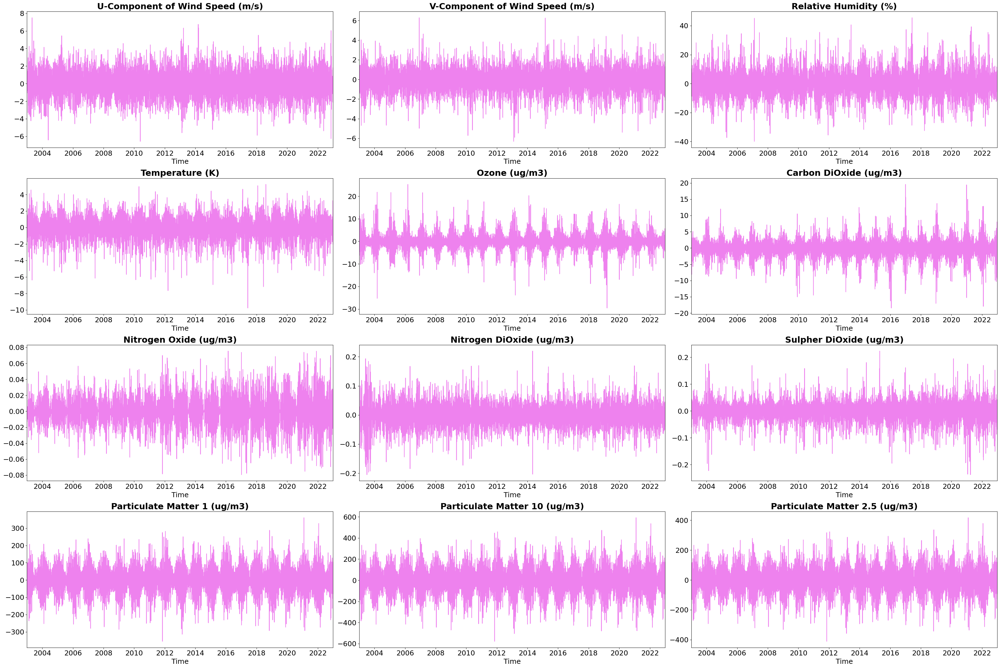

In [89]:
from matplotlib.dates import DateFormatter, AutoDateLocator
import datetime as dt

num_cols = len(df.columns)
num_rows = -(-num_cols // 3)  # Ceil division to ensure all columns are covered

fig, axs = plt.subplots(num_rows, 3, figsize=(36, 24))  # 3 columns

# Flatten the axs array if num_rows > 1 for easier iteration
if num_rows > 1:
    axs = axs.flatten()

for i, column in enumerate(df.columns):
    axs[i].set_xlim([dt.datetime(2003, 1, 1), dt.datetime(2022, 12, 31)])
    axs[i].set_title(labels[column], fontsize=22, fontweight='bold')  # Adjust title text
    axs[i].set_xlabel('Time', fontsize=18)  # Adjust x-axis label
    axs[i].tick_params(axis='both', which='major', labelsize=18)  # Adjust tick labels
    axs[i].plot(df.index, df[column].diff(), color='violet')

# Hide empty subplots if the number of subplots is not a perfect square
if num_cols % 3 != 0:
    for i in range(num_cols, num_rows * 3):
        axs[i].axis('off')

plt.tight_layout()
plt.show()


In [3]:
from statsmodels.tsa.arima.model import ARIMA

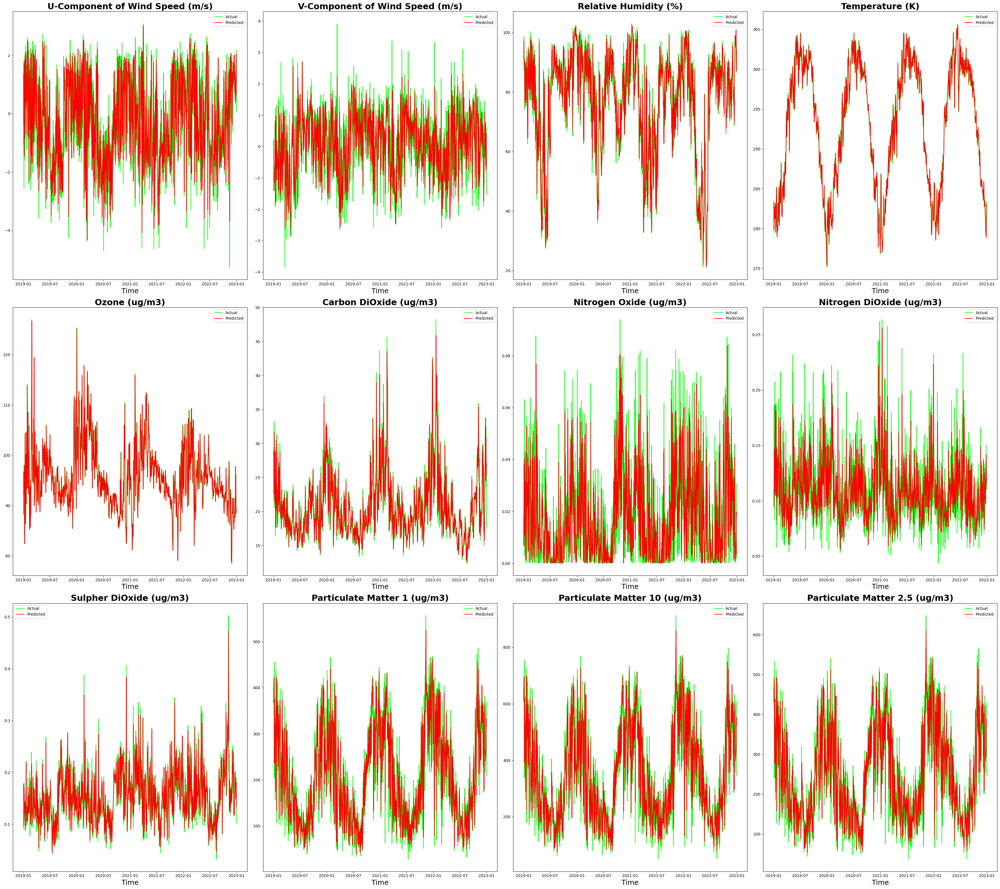

In [107]:
fig, axs = plt.subplots(3, 4, figsize=(36, 32))
column_names = df.columns

for i in range(3):
    for j in range(4):
        n = 4*i + j
        if n < len(column_names):
            model = ARIMA(df[column_names[n]], order=(1, 1, 0))
            model_fit = model.fit()
            predictions = model_fit.predict(start=len(df[column_names[n]])-1460, end=len(df[column_names[n]])-1, dynamic=False)
            axs[i, j].plot(df.index[-1460:], df[column_names[n]][-1460:], label='Actual', color='lime')
            axs[i, j].plot(df.index[-1460:], predictions, label='Predicted', color='red')
            axs[i, j].set_xlabel('Time',fontsize=18)
            axs[i, j].legend()
            axs[i, j].set_title(labels[column_names[n]],fontsize=22, fontweight='bold')

plt.tight_layout()
plt.show()


In [4]:
from fastdtw import fastdtw
from sklearn.metrics import mean_squared_error as mse

In [120]:
for n in df.columns:
    print(n)
    for z in range(5):
        for x in range(2):
            for y in range(5):
                model = ARIMA(df[n][4016:], order=(z, x, y))
                model_fit = model.fit()
                predictions = model_fit.predict(dynamic=False)
                distance, path = fastdtw(predictions,df[n][4016:])
                print(f"{distance},{z},{x},{y},{mse(predictions,df[n][4016:])}")


us
4337.210553107027,0,0,0,2.4155584349776125
3098.7986102221525,0,0,1,1.8874501731026954
2618.8139084092336,0,0,2,1.8238677781630306
2502.905061133474,0,0,3,1.804966582786704
2532.364780906973,0,0,4,1.786118850853292
222.6267698380099,0,1,0,2.3612794549777862
2935.4332152853503,0,1,1,1.8926244147088847
2426.9835940356197,0,1,2,1.6817151814297526
2327.381968376644,0,1,3,1.6765487622912438
2344.860212644773,0,1,4,1.676230965148195
2427.755853128281,1,0,0,1.7844537334449175
2380.969574596992,1,0,1,1.7831419966015227
2414.198598565321,1,0,2,1.6711541527817522
2317.64995072985,1,0,3,1.6666733062373074
2333.220979028783,1,0,4,1.6662068678220507
1077.7131590398922,1,1,0,2.202559264282013
2304.2318505766793,1,1,1,1.6902857444351627
2331.764710899831,1,1,2,1.6770430323951953
2351.969940798761,1,1,3,1.6760316104331818
2337.024655121175,1,1,4,1.6758003832505388
2419.303528363006,2,0,0,1.783728497424612
2424.553174738175,2,0,1,1.7840305474948805
2322.480047862285,2,0,2,1.6671722864305891
2334.349

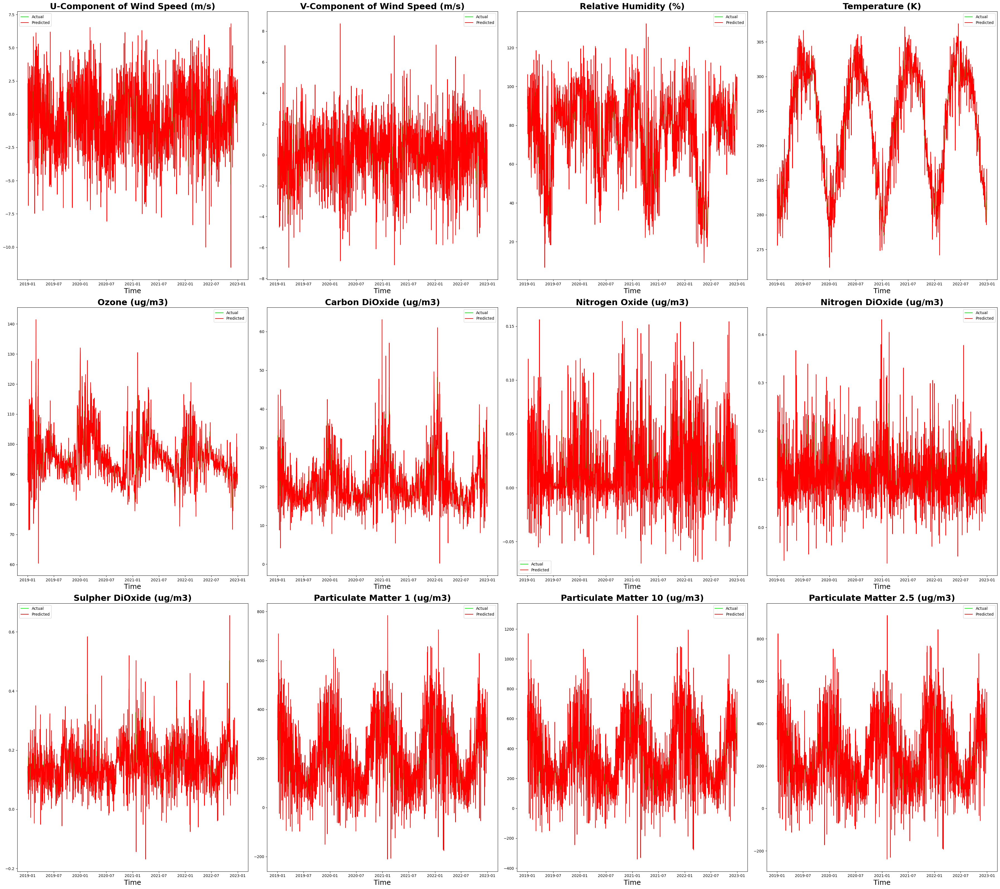

In [150]:
fig, axs = plt.subplots(3, 4, figsize=(36, 32))
column_names = df.columns

for i in range(3):
    for j in range(4):
        n = 4*i + j
        if n < len(column_names):
            model = ARIMA(df[column_names[n]], order=(0, 2, 0))
            model_fit = model.fit()
            predictions = model_fit.predict(start=len(df[column_names[n]])-1460, end=len(df[column_names[n]])-1, dynamic=False)
            axs[i, j].plot(df.index[-1460:], df[column_names[n]][-1460:], label='Actual', color='lime')
            axs[i, j].plot(df.index[-1460:], predictions, label='Predicted', color='red')
            axs[i, j].set_xlabel('Time',fontsize=18)
            axs[i, j].legend()
            axs[i, j].set_title(labels[column_names[n]],fontsize=22, fontweight='bold')

plt.tight_layout()
plt.show()


In [13]:
dates=pd.read_csv('data1.csv')
dates['date']=pd.to_datetime(dates['date'],format='%d/%m/%Y')
dates.set_index('date',inplace=True)
dates=dates.asfreq('D')

In [170]:
model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  pm2.5   No. Observations:                 7304
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -41588.778
Date:                Sun, 12 Nov 2023   AIC                          83183.555
Time:                        05:48:04   BIC                          83204.243
Sample:                    01-02-2003   HQIC                         83190.669
                         - 12-31-2022                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3354      0.012     28.649      0.000       0.312       0.358
ma.L1         -0.8965      0.006   -148.433      0.000      -0.908      -0.885
sigma2      5174.5134     75.046     68.951      0.000    5027.426    5321.601
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):               198.84
Prob(Q):                              0.92   Prob(JB):                         0.00
Heteroskedasticity (H):               1.16   Skew:                            -0.19
Prob(H) (two-sided):                  0.00   Kurtosis:                         3.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [11]:
ppds=pd.DataFrame()

NameError: name 'ARIMA' is not defined

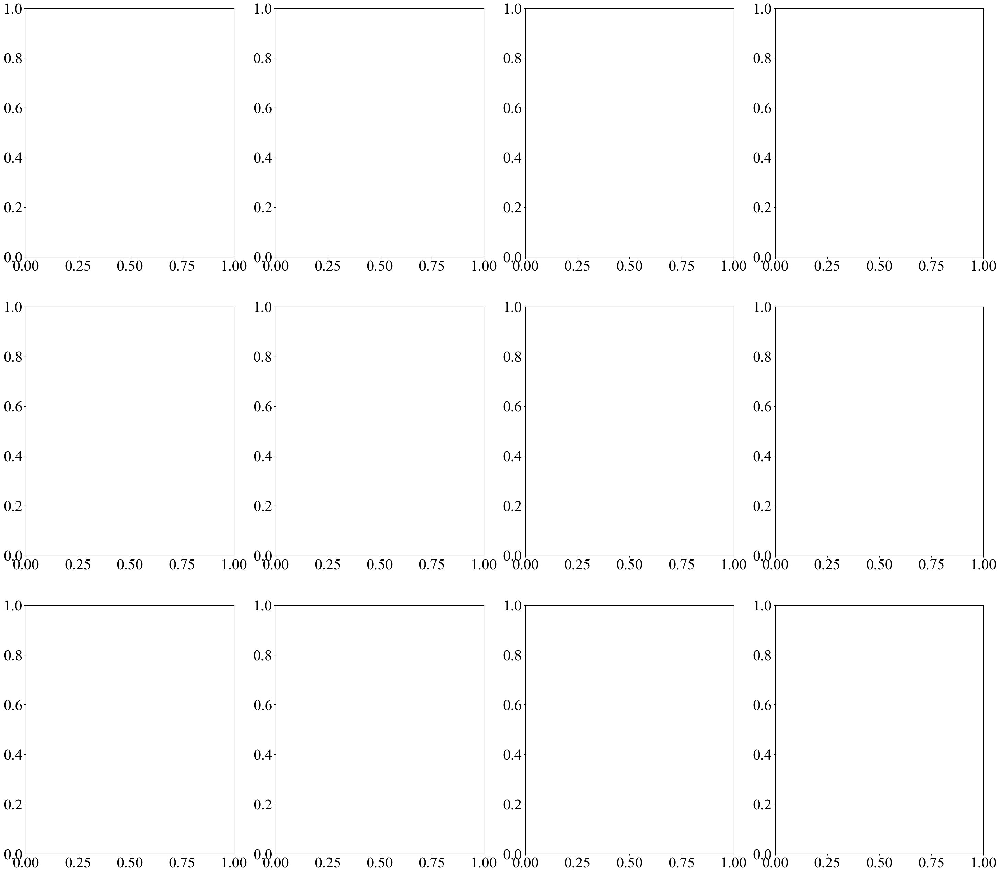

In [17]:
fig, axs = plt.subplots(3, 4, figsize=(36, 32))
column_names = df.columns
for i in range(3):
    for j in range(4):
        index = 4 * i + j
        if index < len(column_names):
            trend = seasonal_decompose(df[column_names[index]],model='additive').trend
            model = ARIMA(trend, order=(2, 0, 1))
            model_fit = model.fit()
            predictions = model_fit.predict(start=0, end=2921)
            seasonal_component = seasonal_decompose(df[column_names[index]],model='additive').seasonal[:2922]
            residual_component = seasonal_decompose(df[column_names[index]],model='additive').resid[:2922]
            if column_names[index] not in ['us', 'vs', 'rh', 'temp']:
                predictions = predictions*1.4
            predictions = predictions + seasonal_component + residual_component
            ppds[column_names[index]]=predictions
            axs[i, j].plot(dates.index, predictions, label='Predicted', color='magenta')
            axs[i, j].set_xlabel('Time', fontsize=18)
            axs[i, j].set_title(labels[column_names[index]], fontsize=22, fontweight='bold')
plt.tight_layout()
plt.show()

In [17]:
ppds['date']=dates.index

In [18]:
ppds.set_index('date',inplace=True)

In [19]:
ppds=ppds.iloc[3:]

In [20]:
ppds30=ppds[ppds.index.year==2030]

In [21]:
ppds30.mean().min()

-0.19442742300007926

In [22]:
listed=[]
for n in ppds30.columns:
    listed.append(labels[n])

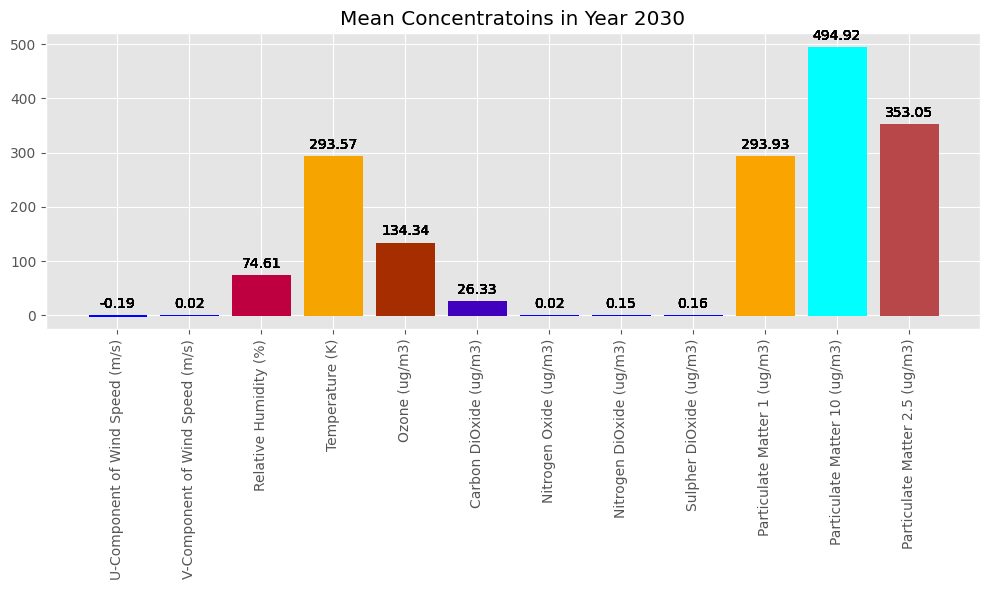

In [23]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

plt.style.use('ggplot')

# Assuming ppds30 and listed are defined
fig, ax = plt.subplots(figsize=(10, 6))
colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
bounds = [0, 0.2, 0.4, 0.6, 0.8, 1]  # Position of each color, from 0 to 1
cmap = mpl.colors.LinearSegmentedColormap.from_list('my_colormap', list(zip(bounds, colors)))
norm = plt.Normalize(ppds30.mean().min(), ppds30.mean().max())
colors = cmap(norm(ppds30.mean()))
index_values = range(len(ppds30.mean()))
for n in ppds30.columns:
    bars = ax.bar(listed, ppds30.mean(), color=colors)
    # Applying colors to each bar
    for bar, color in zip(bars, colors):
        bar.set_color(color)
        height = bar.get_height()
        ax.annotate(f'{height:.2f}', xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

plt.xticks(rotation=90)  # Rotate x-axis labels by 90 degrees
plt.title('Mean Concentratoins in Year 2030')
plt.tight_layout()
plt.show()


In [273]:
ppds

,us,vs,rh,temp,o3,co,no,no2,so2,pm1,pm10,pm2.5
date,,,,,,,,,,,,
2023-01-04,-0.168391,0.237800,98.718837,411.156093,128.227691,26.619055,0.013927,0.155922,0.173603,263.692842,446.285633,318.100105
2023-01-05,0.704863,1.859694,138.143500,390.675609,124.716574,29.888661,0.012376,0.098463,0.129626,400.128364,660.573436,467.889276
2023-01-06,1.588238,0.815606,137.562698,388.987586,134.125138,32.320103,0.014119,0.092985,0.119205,402.155781,664.116976,469.622565
2023-01-07,2.595390,-0.438729,137.808290,390.357218,135.013224,36.518063,0.001139,0.088088,0.143944,290.499334,479.869420,339.039199
2023-01-08,1.667993,0.411501,140.389458,389.701593,132.489546,31.251737,0.008101,0.088297,0.137187,401.243948,662.488485,466.655178
...,...,...,...,...,...,...,...,...,...,...,...,...
2030-12-27,1.599897,-1.148638,117.602734,392.482825,118.749229,32.814019,0.004048,0.180860,0.177229,430.673908,711.346400,502.585512
2030-12-28,1.369376,-0.379358,117.011522,393.318305,119.644177,27.979070,0.005885,0.133371,0.129404,441.001302,728.067924,512.247076
2030-12-29,0.252689,-1.477978,130.041246,395.922826,127.900178,37.559155,0.012396,0.125578,0.107994,362.936949,600.502138,423.316446


In [24]:
ppds30['Month'] = ppds30.index.month  # Create a new column for month
ppds30['Year'] = ppds30.index.year
monthly=pd.DataFrame()
for n in range(1,13):
    specific_month_data = ppds30[ppds30['Month'] == n]
    monthly[n] = specific_month_data.mean()

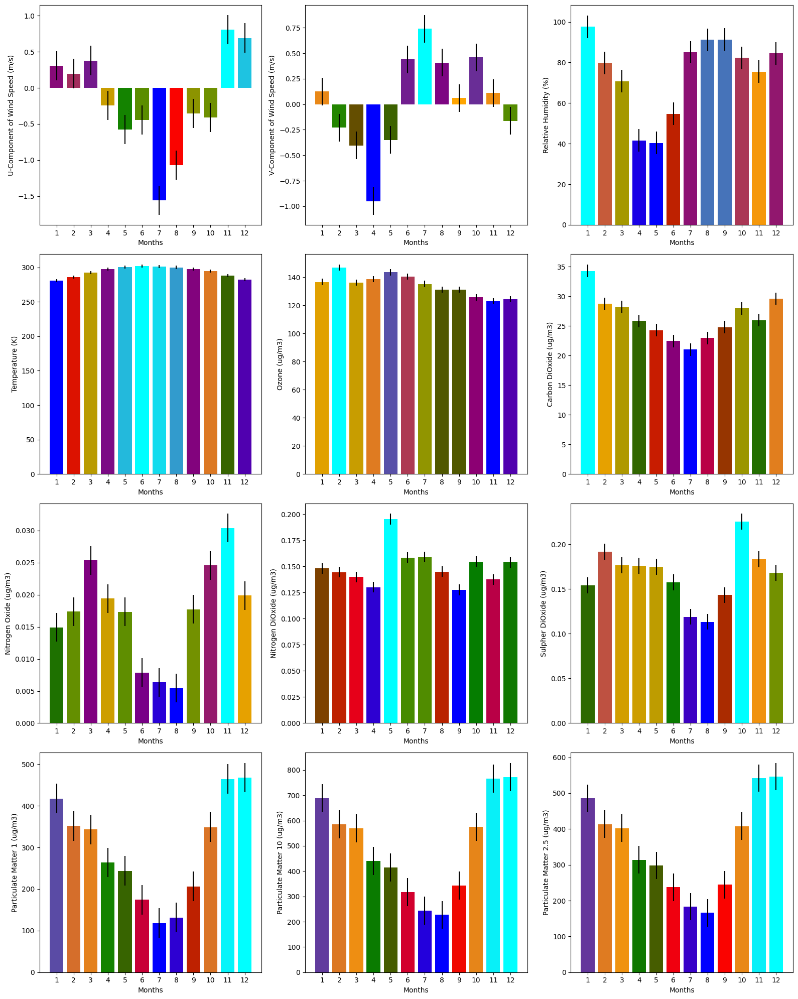

In [25]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
plt.style.use('default')
fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(16, 20))
colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
bounds = [0, 0.2, 0.4, 0.6, 0.8, 1]  # Position of each color, from 0 to 1
cmap = mpl.colors.LinearSegmentedColormap.from_list('my_colormap', list(zip(bounds, colors)))

# Assuming "monthly" and "labels" are defined somewhere in your code for the data

for i, n in enumerate(monthly.index[:-2]):
    if i < 13:
        row = i // 3
        col = i % 3

        # Shift the last plot from the 1st column in the 5th row to the 2nd column
        if i == 12:  # For the last plot
            row = 4  # 5th row
            col = 1  # 2nd column

        ax = axs[row, col]

        norm = plt.Normalize(monthly.loc[n].min(), monthly.loc[n].max())
        colors = cmap(norm(monthly.loc[n]))

        ax.bar(monthly.loc[n].index.astype(str), monthly.loc[n],
               yerr=monthly.loc[n].std() / np.sqrt(len(monthly.loc[n])),
               color=colors)

        ax.set_xlabel('Months')
        ax.set_ylabel(labels[n])
        #ax.grid(False)
plt.tight_layout()
plt.show()

In [26]:
ppds.to_csv('predictions.csv')